# Analisi 1


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%reload_ext google.colab.data_table

In [ ]:
from google.colab import data_table

data_table._DEFAULT_FORMATTERS[float] = lambda x: f"{x:.2f}"
# help(data_table)
# data_table.DataTable(data.airports(), include_index=False, num_rows_per_page=10)

In [ ]:
import pandas as pd
import numpy as np
import os

In [ ]:
#folder_path = os.path.abspath("..")

folder_path = os.path.abspath('drive/MyDrive/Colab Notebooks/')

data_dir = 'dataset/rome-airbnb-zip'
filename = 'listings.csv'
filepath = os.path.join(folder_path, data_dir, filename)

listings_raw = pd.read_csv(filepath)
listings_raw.head(10000)

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,2737,https://www.airbnb.com/rooms/2737,20210210175822,2021-02-13,"Elif's room in cozy, clean flat.",10 min by bus you can get to Piazza Venezia or...,It used to be an industrial area until late 80...,https://a0.muscache.com/pictures/41225252/e955...,3047,https://www.airbnb.com/users/show/3047,Elif,2008-09-18,"Rome, Lazio, Italy",I am a Turkish-Italian who was born in Istanbu...,within a day,100%,0%,f,https://a0.muscache.com/im/users/3047/profile_...,https://a0.muscache.com/im/users/3047/profile_...,Testaccio,5.0,5.0,"['email', 'phone', 'reviews']",t,f,"Rome, Lazio, Italy",VIII Appia Antica,NaN,41.87218,12.48355,Private room,Private room,1,NaN,1.5 baths,1.0,0.0,"[""Free parking on premises"", ""Elevator"", ""Drye...",$21.00,7,1125,7,7,1125,1125,7.0,1125.0,NaN,t,30,60,90,365,2021-02-13,7,0,0,2014-12-26,2015-05-28,96.0,9.0,9.0,10.0,10.0,9.0,9.0,NaN,f,5,0,5,0,0.09
1,2903,https://www.airbnb.com/rooms/2903,20210210175822,2021-02-12,Stay a night in Calisto6 B&B Rome,<b>The space</b><br />Calisto6 B&B is an Itali...,NaN,https://a0.muscache.com/pictures/6315103/3f4d3...,3280,https://www.airbnb.com/users/show/3280,Andrea,2008-09-28,"Rome, Lazio, Italy",NaN,within a few hours,100%,100%,f,https://a0.muscache.com/im/users/3280/profile_...,https://a0.muscache.com/im/users/3280/profile_...,Trastevere,3.0,3.0,"['email', 'phone', 'facebook', 'reviews']",t,f,NaN,I Centro Storico,NaN,41.88826,12.47002,Private room in bed and breakfast,Private room,4,NaN,1 bath,1.0,2.0,"[""Shampoo"", ""Indoor fireplace"", ""TV"", ""Dedicat...",$37.00,1,730,1,1,730,730,1.0,730.0,NaN,t,30,60,90,365,2021-02-12,55,0,0,2008-11-16,2017-10-31,86.0,9.0,9.0,9.0,9.0,9.0,9.0,NaN,f,3,0,3,0,0.37
2,3079,https://www.airbnb.com/rooms/3079,20210210175822,2021-02-13,Cozy apartment (2-4)with Colisseum view,With the view of the Colisseum from the front ...,Monti neighborhood is one of the best areas in...,https://a0.muscache.com/pictures/e85b119c-3667...,3504,https://www.airbnb.com/users/show/3504,Laura,2008-10-08,"Rome, Lazio, Italy",I've a degree in Art History\r\n,NaN,NaN,67%,f,https://a0.muscache.com/im/users/3504/profile_...,https://a0.muscache.com/im/users/3504/profile_...,Monti,7.0,7.0,"['email', 'phone', 'reviews']",t,f,"Rome, Lazio, Italy",I Centro Storico,NaN,41.89503,12.49163,Entire apartment,Entire home/apt,4,NaN,1 bath,1.0,4.0,"[""Paid parking off premises"", ""Washer"", ""Dedic...",$105.00,3,120,3,3,120,120,3.0,120.0,NaN,t,1,1,1,1,2021-02-13,17,0,0,2011-01-02,2018-10-01,88.0,8.0,9.0,9.0,10.0,10.0,9.0,NaN,f,7,7,0,0,0.14
3,11834,https://www.airbnb.com/rooms/11834,20210210175822,2021-02-11,"Roma ""Charming Boschetto House""",<b>The space</b><br />New Wi Fi installed!!!<b...,NaN

In [ ]:
# Selezioniamo solo alcune delle colonne
listings = listings_raw[[
    'id','name','longitude','latitude',
    'instant_bookable',
    'host_response_time',
    'neighbourhood',
    'review_scores_rating',
    'property_type',
    'room_type','accommodates',
    'bathrooms','bedrooms','beds','reviews_per_month', #'amenities',
    'number_of_reviews',
    'price'
  ]]
listings.head(10000)

,id,name,longitude,latitude,instant_bookable,host_response_time,neighbourhood,review_scores_rating,property_type,room_type,accommodates,bathrooms,bedrooms,beds,reviews_per_month,number_of_reviews,price
0,2737,"Elif's room in cozy, clean flat.",12.48355,41.87218,f,within a day,"Rome, Lazio, Italy",96.0,Private room,Private room,1,NaN,1.0,0.0,0.09,7,$21.00
1,2903,Stay a night in Calisto6 B&B Rome,12.47002,41.88826,f,within a few hours,NaN,86.0,Private room in bed and breakfast,Private room,4,NaN,1.0,2.0,0.37,55,$37.00
2,3079,Cozy apartment (2-4)with Colisseum view,12.49163,41.89503,f,NaN,"Rome, Lazio, Italy",88.0,Entire apartment,Entire home/apt,4,NaN,1.0,4.0,0.14,17,$105.00
3,11834,"Roma ""Charming Boschetto House""",12.49058,41.89574,f,NaN,NaN,95.0,Entire apartment,Entire home/apt,2,NaN,1.0,1.0,1.19,142,$90.00
4,12398,Casa Donatello - Home far from Home,12.46809,41.92584,f,within an hour,"Rome, Lazio, Italy",98.0,Entire apartment,Entire home/apt,5,NaN,2.0,3.0,0.32,40,$73.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,15457185,LEONEQUARTO,12.45540,41.91075,t,a few days or more,"Rome, Lazio, Italy",99.0,Entire apartment,Entire home/apt,6,NaN,3.0,4.0,3.04,153,$160.00
9996,15457978,Authentic Family apartment Rome,12.52765,41.89188,t,NaN,"Rome, Lazio, Italy",87.0,Entire apartment,Entire home/apt,4,NaN,2.0,3.0,0.21,10,$105.00
9997,15458251,Cozy and large private room,12.55728,41.89406,f,NaN,NaN,97.0,Private room in apartment,Private room,2,NaN,1.0,1.0,1.33,70,$30.00
9998,15462332,Apartment Luxury Pantheon,12.47685,41.89598,t,within an hour,NaN,100.0,Entire apartment,Entire home/apt,10,NaN,3.0,6.0,0.08,4,$200.00


# Data preparation



## Price da stringa a numero reale

In [ ]:
# PREVIOUS WAY
# @np.vectorize
# def remove_dollar(label: str):
#   return float(label.replace('$','').replace(',',''))

listings_2 = listings.assign(price = listings.price.str.replace('\\$|,','').astype(float))
listings_2['price']

0          21.0
1          37.0
2         105.0
3          90.0
4          73.0
          ...  
27642      44.0
27643      44.0
27644      38.0
27645    1802.0
27646      94.0
Name: price, Length: 27647, dtype: float64

## Analisi del Tipo di stanza ('room_type')

Studiamo le differenze tra i differenti tipi di stanze. 

Gli "host" di Airbnb possono affittare case/appartamenti interi, stanze private o condivise.

Secondo la tipologia di alloggio offerto e il tasso di attività, un annuncio di Airbnb potrebbe funzionare in maniera più simile ad un hotel non regolamentato, essere di disturbo al vicinato, sottrarre disponibilità di alloggi al settore residenziale ed essere illegale.


### Livelli


In [ ]:
# levels
list( listings_2['room_type'].unique() )

['Private room', 'Entire home/apt', 'Hotel room', 'Shared room']

# Plotnine

[plotnine](https://plotnine.readthedocs.io/en/stable/index.html) is an implementation of a grammar of graphics in Python, it is based on ggplot2. The grammar allows users to compose plots by explicitly mapping data to the visual objects that make up the plot.

Resources: 

- [Source Code](https://github.com/has2k1/plotnine)
- [a plotnine book](https://f0nzie.github.io/rmarkdown-python-plotnine)


# New Section

In [ ]:
!pip install -U plotnine
from plotnine import *

     |████████████████████████████████| 4.7MB 4.4MB/s 
     |████████████████████████████████| 9.5MB 29.4MB/s 
     |████████████████████████████████| 71kB 8.1MB/s 
     |████████████████████████████████| 27.4MB 118kB/s 
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: scipy 1.4.1
    Uninstalling scipy-1.4.1:
      Successfully uninstalled scipy-1.4.1
  Found existing installation: statsmodels 0.10.2
    Uninstalling statsmodels-0.10.2:
      Successfully uninstalled statsmodels-0.10.2
  Found existing installation: mizani 0.6.0
    Uninstalling mizani-0.6.0:
      Successfully uninstalled mizani-0.6.0
  Found existing installation: plotnine 0.6.0
    Uninstalling plotnine-0.6.0:
      Successfully uninstalled plotnine-0.6.0


## Categorical variables

### Examples of categorical variables


In [ ]:
room_type_levels = listings_2['room_type'].unique()
room_type_levels

array(['Private room', 'Entire home/apt', 'Hotel room', 'Shared room'],
      dtype=object)

### Bar plot


In [ ]:
# 'listing' count per 'room_type'
room_type_price = listings_2\
  .groupby('room_type', dropna=False)\
  .agg(
        count      = ( 'price', lambda x: x.count()),
        mean_price = ( 'price', lambda x: np.mean(x) ),
        std_price  = ( 'price', lambda x: np.std(x, ddof=0) )
  )\
  .reset_index()

room_type_price

,room_type,count,mean_price,std_price
0,Entire home/apt,17248.0,114.339170,258.163000
1,Hotel room,1276.0,96.080721,143.839346
2,Private room,8923.0,90.041690,477.719385
3,Shared room,200.0,38.740000,64.370120


#### Single Categorical Variable

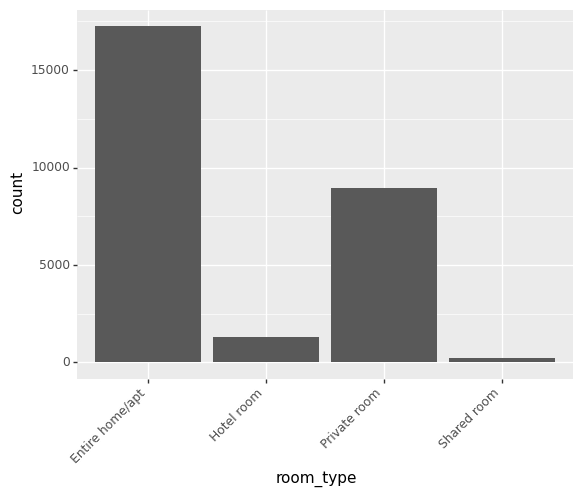

<ggplot: (8787012230953)>

In [ ]:
# Bar plot to count by group

ggplot(listings) +\
  aes(x='room_type') +\
  geom_bar() +\
  theme(axis_text_x=element_text(angle=45, hjust=1))

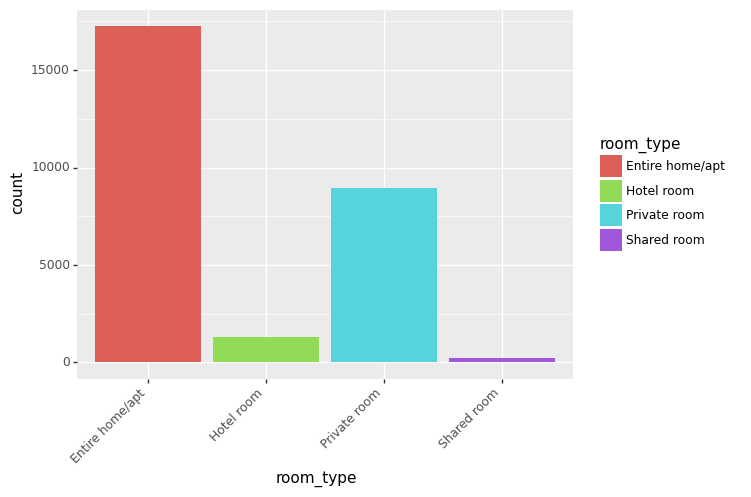

<ggplot: (8787012229285)>

In [ ]:
# Redundant color

ggplot(listings_2) +\
  aes(x='room_type',fill='room_type') +\
  geom_bar() +\
  theme(axis_text_x=element_text(angle=45, hjust=1))

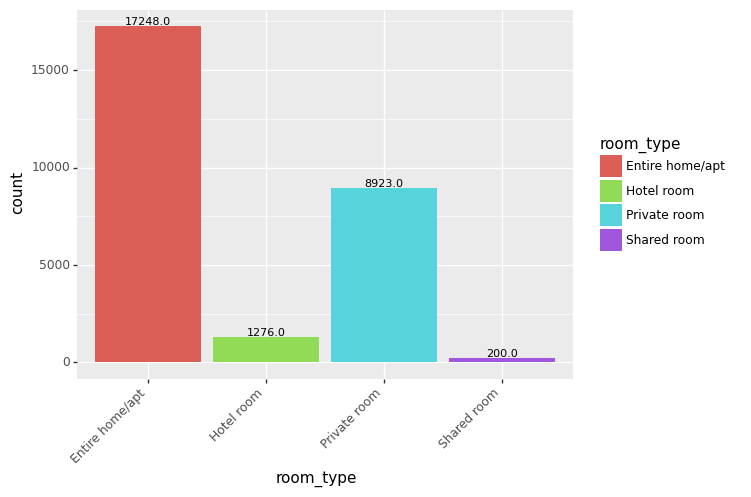

<ggplot: (8787002011009)>

In [ ]:
dodge_text = position_dodge(width=0.9)

ggplot(room_type_price)\
  + aes(x='room_type', y='count', fill='room_type')\
  + geom_bar(stat='identity')\
  + theme(axis_text_x=element_text(angle=45, hjust=1))\
  + geom_text(aes(label='count'),                                    # new
              position=dodge_text,
              size=8, va='bottom')


In [ ]:
room_type_rounded_price = room_type_price.assign(
      mean_price = lambda _: np.round(_['mean_price'],2),
      std_price  = lambda _: np.round(_['std_price'],2)
    )

room_type_rounded_price

,room_type,count,mean_price,std_price
0,Entire home/apt,17248.0,114.34,258.16
1,Hotel room,1276.0,96.08,143.84
2,Private room,8923.0,90.04,477.72
3,Shared room,200.0,38.74,64.37


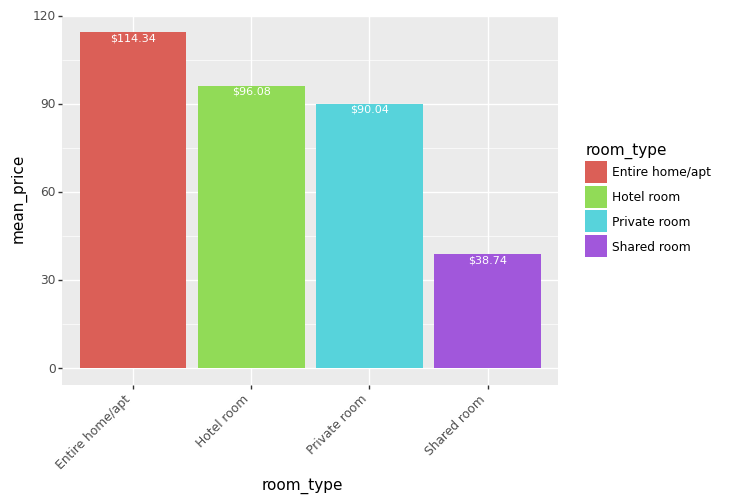

<ggplot: (8787012256253)>

In [ ]:
dodge_text = position_dodge(width=0.9)

ggplot(room_type_rounded_price)\
  + aes(x='room_type', y='mean_price', fill='room_type')\
  + geom_bar(stat='identity')\
  + theme(axis_text_x=element_text(angle=45, hjust=1))\
  + geom_text(aes(label='mean_price'),                                    # new
              position=dodge_text,
              size=8, colour='white', va='top',
              format_string='${}')
  

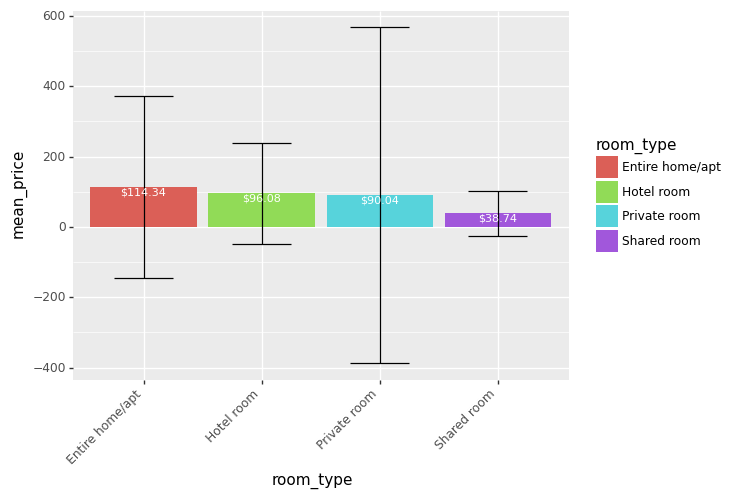

<ggplot: (8787001952181)>

In [ ]:
dodge_text = position_dodge(width=0.9)

ggplot(room_type_rounded_price)\
  + aes(x='room_type', y='mean_price', fill='room_type')\
  + geom_bar(stat='identity')\
  + theme(axis_text_x=element_text(angle=45, hjust=1))\
  + geom_errorbar(aes(x="room_type", ymin="mean_price-std_price",ymax="mean_price+std_price"))\
  + geom_text(aes(label='mean_price'),                                    
              position=dodge_text,
              size=8, colour='white', va='top',
              format_string='${}')\

In [ ]:
listings_2['property_type'].unique()

array(['Private room', 'Private room in bed and breakfast',
       'Entire apartment', 'Private room in apartment',
       'Private room in guesthouse', 'Entire loft', 'Entire condominium',
       'Entire villa', 'Private room in guest suite',
       'Private room in condominium', 'Room in bed and breakfast',
       'Private room in villa', 'Private room in house',
       'Room in serviced apartment', 'Entire guesthouse',
       'Entire cottage', 'Private room in loft', 'Farm stay',
       'Private room in serviced apartment', 'Entire guest suite',
       'Entire bed and breakfast', 'Room in boutique hotel',
       'Entire house', 'Tiny house', 'Shared room in apartment',
       'Private room in boat', 'Entire serviced apartment',
       'Entire cabin', 'Private room in nature lodge',
       'Shared room in hostel', 'Room in aparthotel', 'Entire bungalow',
       'Room in hotel', 'Entire townhouse', 'Private room in townhouse',
       'Room in pension', 'Private room in castle',
      

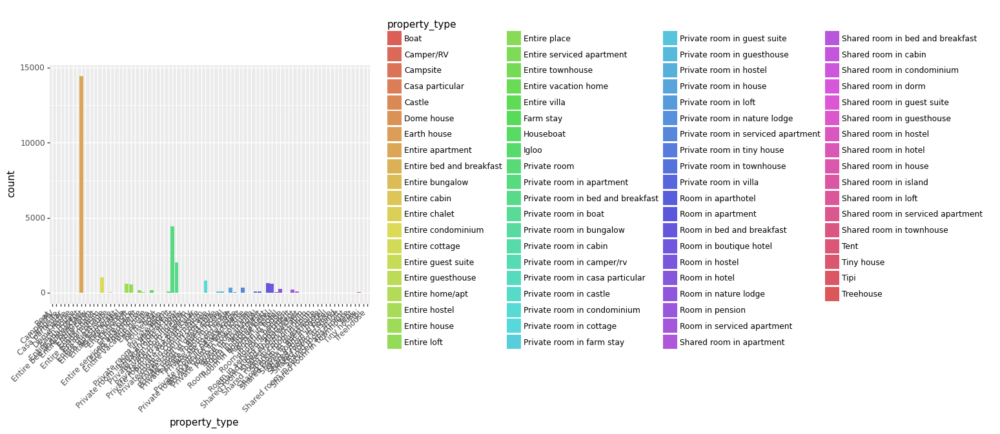

<ggplot: (8787001916093)>

In [ ]:
# Single variable

from plotnine import *

ggplot(listings_2) +\
  aes(x='property_type', fill='property_type') +\
  geom_bar() +\
  theme(axis_text_x=element_text(angle=45, hjust=1))
  # theme(legend_position = "none")


#### Two categorical Variable

In [ ]:
listings_private_rooms = listings_2[lambda _: _['property_type'].str.contains('guesthouse|apartment')]
listings_private_rooms

,id,name,longitude,latitude,instant_bookable,host_response_time,neighbourhood,review_scores_rating,property_type,room_type,accommodates,bathrooms,bedrooms,beds,reviews_per_month,number_of_reviews,price
2,3079,Cozy apartment (2-4)with Colisseum view,12.49163,41.89503,f,NaN,"Rome, Lazio, Italy",88.0,Entire apartment,Entire home/apt,4,NaN,1.0,4.0,0.14,17,105.0
3,11834,"Roma ""Charming Boschetto House""",12.49058,41.89574,f,NaN,NaN,95.0,Entire apartment,Entire home/apt,2,NaN,1.0,1.0,1.19,142,90.0
4,12398,Casa Donatello - Home far from Home,12.46809,41.92584,f,within an hour,"Rome, Lazio, Italy",98.0,Entire apartment,Entire home/apt,5,NaN,2.0,3.0,0.32,40,73.0
5,14181,Beautiful apt close to the Vatican,12.45321,41.91485,f,NaN,"Rome, Lazio, Italy",97.0,Private room in apartment,Private room,1,NaN,1.0,1.0,0.22,28,187.0
6,15409,VATICAN SAN PIETRO 5min From Vatican,12.45022,41.89538,f,NaN,"Rome, Lazio, Italy",98.0,Entire apartment,Entire home/apt,10,NaN,2.0,16.0,NaN,0,100.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27634,48081619,Casa Sole... Ed é subito casa! :),12.52229,41.92952,t,NaN,NaN,NaN,Entire apartment,Entire home/apt,4,NaN,1.0,2.0,NaN,0,48.0
27635,48085046,Garbatella experience! a 5 minuti veri dalla M...,12.48242,41.86510,f,within a few hours,"Rome, Lazio, Italy",NaN,Entire apartment,Entire home/apt,3,NaN,2.0,0.0,NaN,0,50.0
27637,48089420,Unique location with a private bathroom,12.47528,41.87303,t,within an hour,NaN,NaN,Private room in apartment,Private room,2,NaN,1.0,1.0,NaN,0,40.0
27642,48106329,SECRET-TIMELESS and-Romantic-Studio-JANICULUM ...,12.46329,41.87845,f,NaN,"Rome, Lazio, Italy",NaN,Entire apartment,Entire home/apt,2,NaN,1.0,1.0,NaN,0,44.0


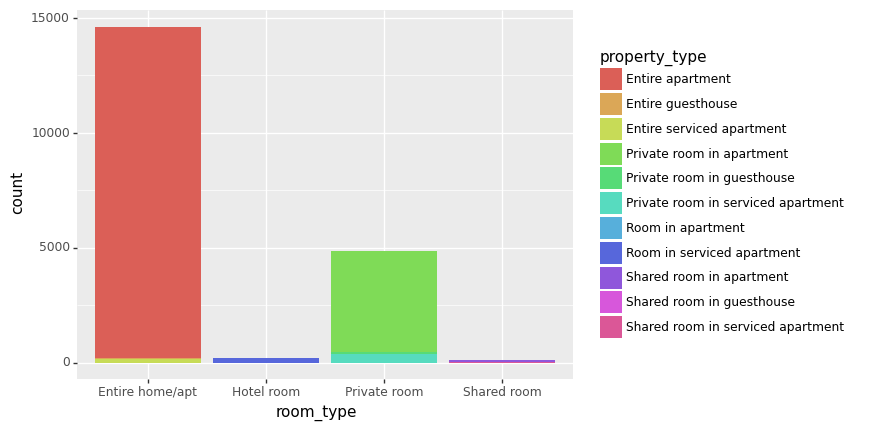

<ggplot: (8787001617297)>

In [ ]:
# two categorical variables
ggplot(listings_private_rooms) +\
  aes(x='room_type', fill='property_type') +\
  geom_bar()

## Continuous Variable

### Binning a real value

In [ ]:
n_bins = 30

price_bin = listings_2[['price']]\
  .loc[lambda _: _.price < 200]\
  .assign(
        bin = lambda _: pd.cut(_.price, n_bins)
      )

price_bin

,price,bin
0,21.0,"(19.9, 26.533]"
1,37.0,"(33.167, 39.8]"
2,105.0,"(99.5, 106.133]"
3,90.0,"(86.233, 92.867]"
4,73.0,"(72.967, 79.6]"
...,...,...
27641,41.0,"(39.8, 46.433]"
27642,44.0,"(39.8, 46.433]"
27643,44.0,"(39.8, 46.433]"
27644,38.0,"(33.167, 39.8]"


In [ ]:
price_bin\
  .groupby('bin')\
  .agg(
      #left_side_bin = ('price', lambda x: x.min()),
      count = ('price', lambda x: x.count())
  )

,count
bin,
"(-0.199, 6.633]",6.0
"(6.633, 13.267]",98.0
"(13.267, 19.9]",389.0
"(19.9, 26.533]",1139.0
"(26.533, 33.167]",1497.0
"(33.167, 39.8]",1573.0
"(39.8, 46.433]",2617.0
"(46.433, 53.067]",2584.0
"(53.067, 59.7]",1655.0


### Histogram


/usr/local/lib/python3.7/dist-packages/plotnine/layer.py:324: PlotnineWarning: stat_bin : Removed 1722 rows containing non-finite values.
/usr/local/lib/python3.7/dist-packages/plotnine/layer.py:401: PlotnineWarning: geom_histogram : Removed 2 rows containing missing values.


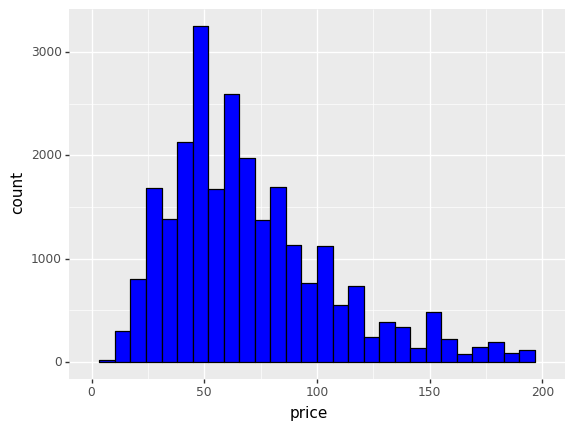

<ggplot: (8787001578949)>

In [ ]:
ggplot(listings_2) + aes(x='price') +\
  geom_histogram(fill='blue', colour='black', bins=30) +\
  xlim(0, 200)

### Density plot

/usr/local/lib/python3.7/dist-packages/plotnine/layer.py:324: PlotnineWarning: stat_density : Removed 39 rows containing non-finite values.


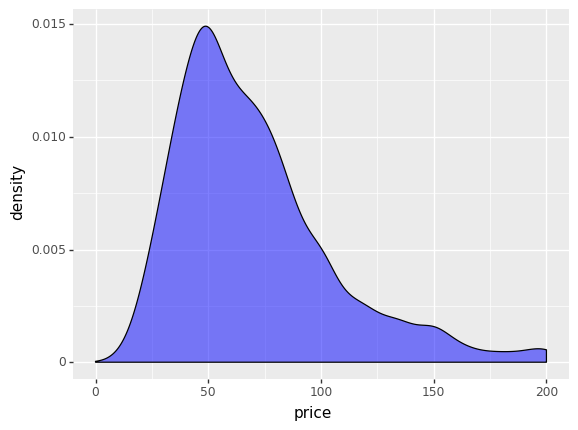

<ggplot: (8787001548481)>

In [ ]:
ggplot(listings_2.head(1000)) + aes(x='price') +\
  geom_density(fill = 'blue', colour = 'black', alpha = 0.5) +\
  xlim(0,200)

### Density Histogram

/usr/local/lib/python3.7/dist-packages/plotnine/layer.py:324: PlotnineWarning: stat_density : Removed 541 rows containing non-finite values.
/usr/local/lib/python3.7/dist-packages/plotnine/layer.py:324: PlotnineWarning: stat_bin : Removed 541 rows containing non-finite values.
/usr/local/lib/python3.7/dist-packages/plotnine/layer.py:401: PlotnineWarning: geom_histogram : Removed 79 rows containing missing values.


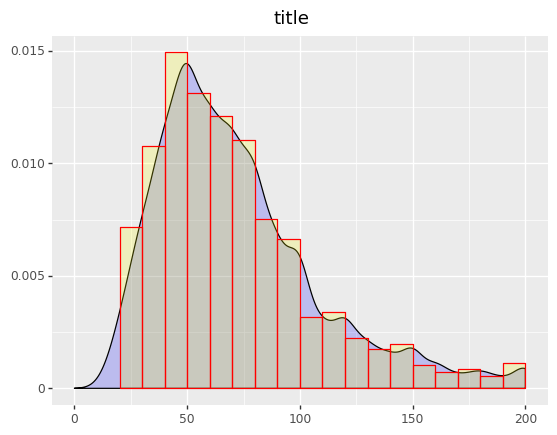

<ggplot: (8787001550969)>

In [ ]:
ggplot(listings_2.head(10000)) +  aes(x='price') +\
  geom_density(fill='blue', alpha=0.2) +\
  geom_histogram(mapping=aes(y=after_stat('density')),
                 breaks=np.arange(20, 1000, 10),
                 colour="red",
                 fill="yellow",
                 alpha=0.2) +\
  xlim(0, 200) +\
  labs(title="title", x="", y="")

/usr/local/lib/python3.7/dist-packages/plotnine/layer.py:324: PlotnineWarning: stat_density : Removed 366 rows containing non-finite values.


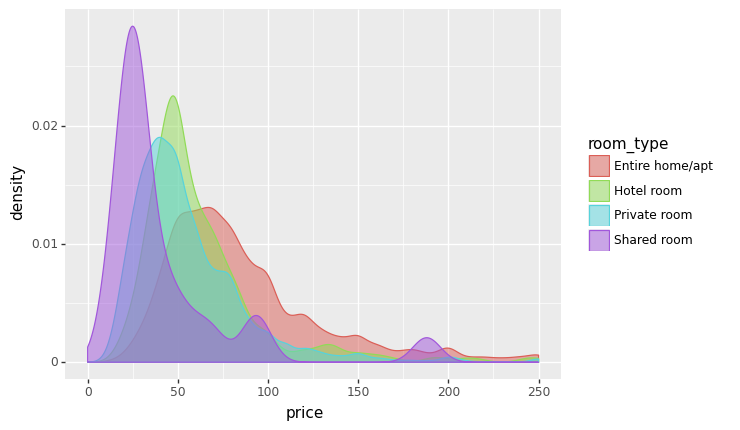

<ggplot: (8787001835341)>

In [ ]:
ggplot(listings_2.head(10000)) +\
  aes(x='price', fill='room_type', colour='room_type') +\
  geom_density(alpha=0.5) +\
  xlim(0, 250)

/usr/local/lib/python3.7/dist-packages/plotnine/layer.py:324: PlotnineWarning: stat_bin : Removed 1722 rows containing non-finite values.
/usr/local/lib/python3.7/dist-packages/plotnine/layer.py:401: PlotnineWarning: geom_histogram : Removed 8 rows containing missing values.


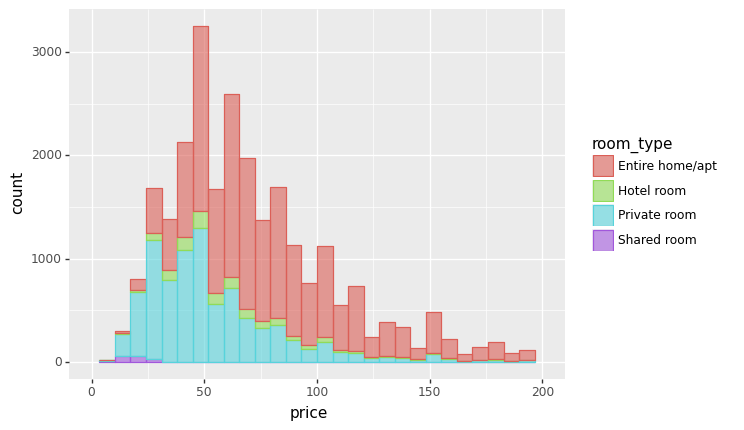

<ggplot: (8787002039157)>

In [ ]:
ggplot(listings_2) + aes(x='price', fill='room_type', colour='room_type') +\
  geom_histogram(bins=30, alpha=0.6) +\
  xlim(0, 200)

### Scatter plot

### On geographical coordinates

In [ ]:
selected_property_type = listings_2.property_type.unique()[0:7]
selected_neighbourhood = listings_2.neighbourhood.unique()[0:7]

ds = listings_2[
                  listings_2.property_type.isin(selected_property_type) & 
                  listings_2.neighbourhood.isin(selected_neighbourhood)
                ].sample(10000)
              

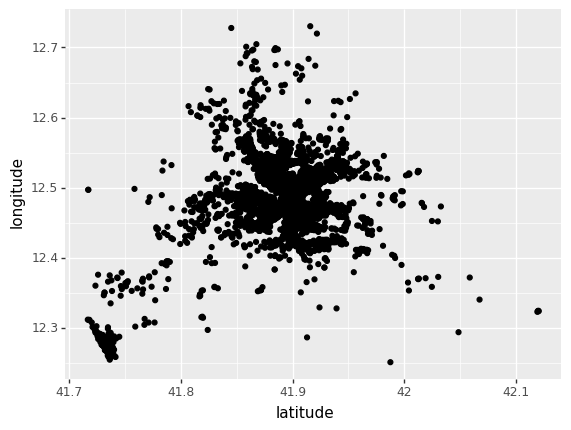

<ggplot: (8787010986577)>

In [ ]:
ggplot(ds, aes(x='latitude', y='longitude')) +\
  geom_point()

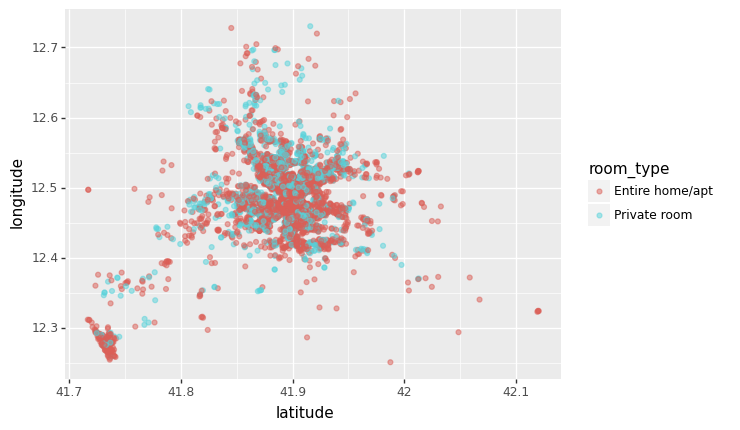

<ggplot: (8787001955045)>

In [ ]:
# color categorical variable
ggplot(ds, aes(x='latitude', y='longitude', colour='room_type')) +\
  geom_point(alpha=0.5)

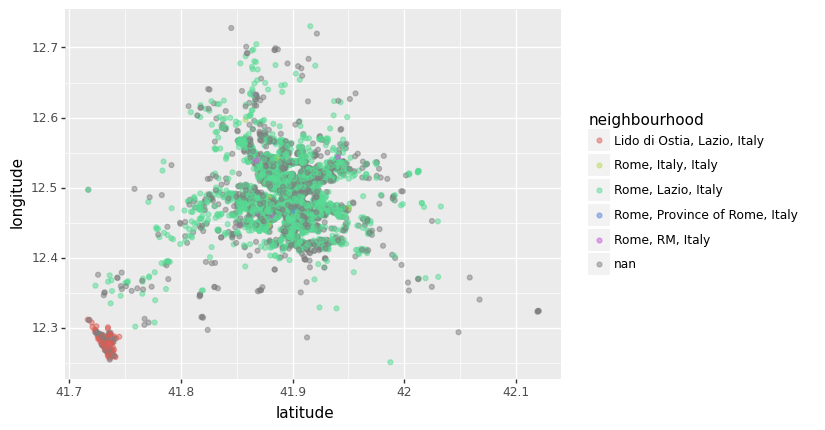

<ggplot: (8787001451381)>

In [ ]:
ggplot(ds, aes(x='latitude', y='longitude', colour='neighbourhood')) +\
  geom_point(alpha=0.5) 

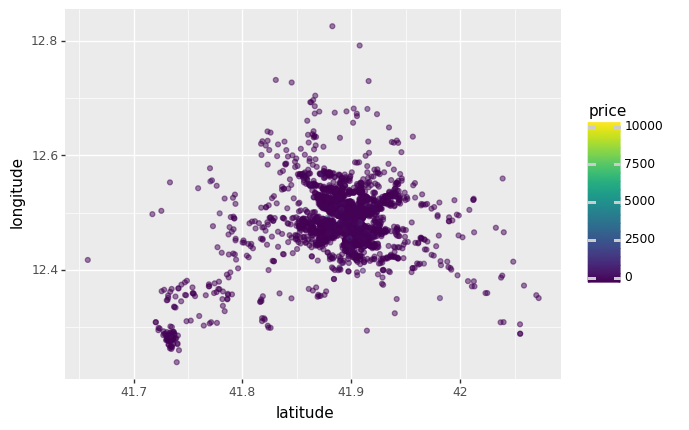

<ggplot: (8787001347897)>

In [ ]:
# color continuous variable
ggplot(listings_2.sample(5000), aes(x='latitude', y='longitude', colour='price')) +\
  geom_point(alpha=0.5)

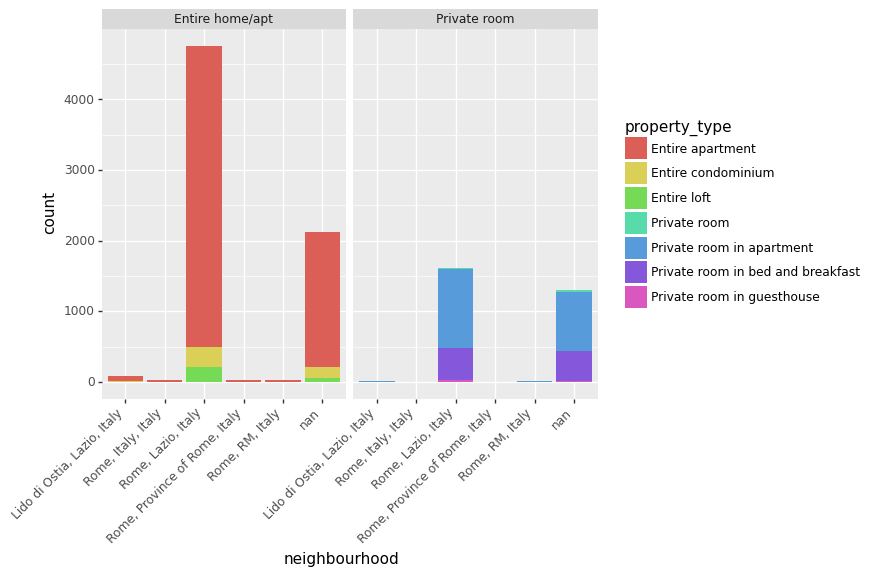

<ggplot: (8787001766065)>

In [ ]:
ggplot(ds, aes(x = 'neighbourhood', fill = 'property_type')) +\
  geom_bar() +\
  facet_wrap('room_type', nrow=1) +\
  theme(axis_text_x = element_text(angle = 45, hjust=1))

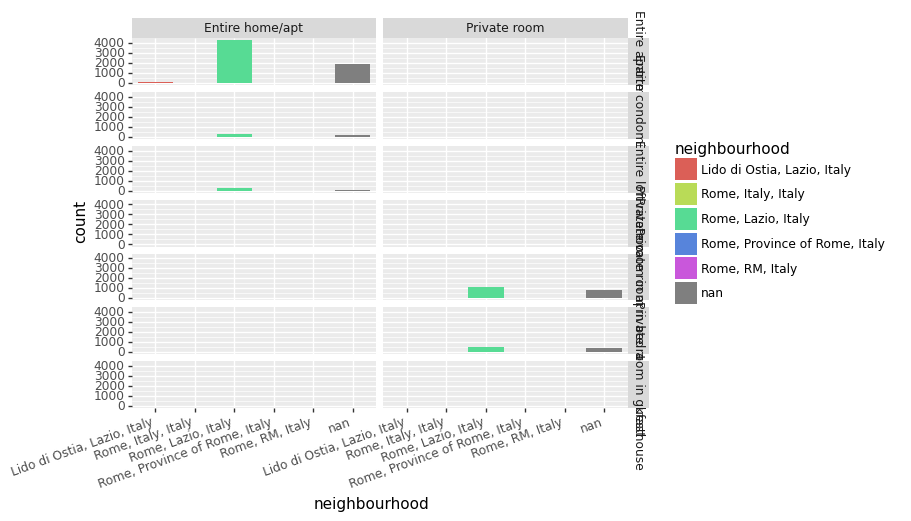

<ggplot: (8787000977149)>

In [ ]:
ggplot(ds, aes(x='neighbourhood', fill='neighbourhood')) +\
  geom_bar() +\
  facet_grid('property_type ~room_type') +\
  theme(axis_text_x = element_text(angle = 20, hjust=1))

### Boxplot

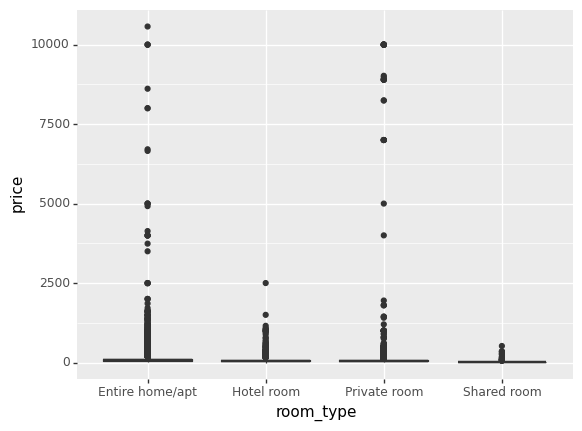

<ggplot: (8787001675937)>

In [ ]:


ggplot(listings_2) +\
    aes(x='room_type', y='price') +\
    geom_boxplot()

/usr/local/lib/python3.7/dist-packages/plotnine/layer.py:324: PlotnineWarning: stat_boxplot : Removed 1722 rows containing non-finite values.
/usr/local/lib/python3.7/dist-packages/plotnine/layer.py:324: PlotnineWarning: stat_summary : Removed 1722 rows containing non-finite values.


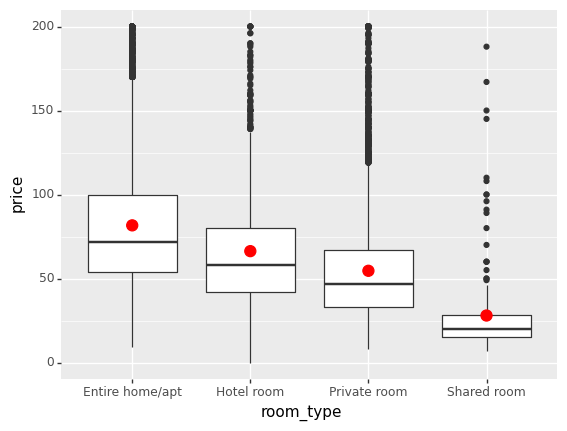

<ggplot: (8787002016173)>

In [ ]:
ggplot(listings_2) +\
    aes(x='room_type', y='price') +\
    geom_boxplot() +\
    stat_summary(fun_y=np.mean, geom="point", size=4, color="red", fill="red") +\
    ylim(0, 200)

/usr/local/lib/python3.7/dist-packages/plotnine/layer.py:324: PlotnineWarning: stat_boxplot : Removed 62 rows containing non-finite values.
/usr/local/lib/python3.7/dist-packages/plotnine/layer.py:324: PlotnineWarning: stat_summary : Removed 62 rows containing non-finite values.
/usr/local/lib/python3.7/dist-packages/plotnine/layer.py:401: PlotnineWarning: geom_jitter : Removed 69 rows containing missing values.


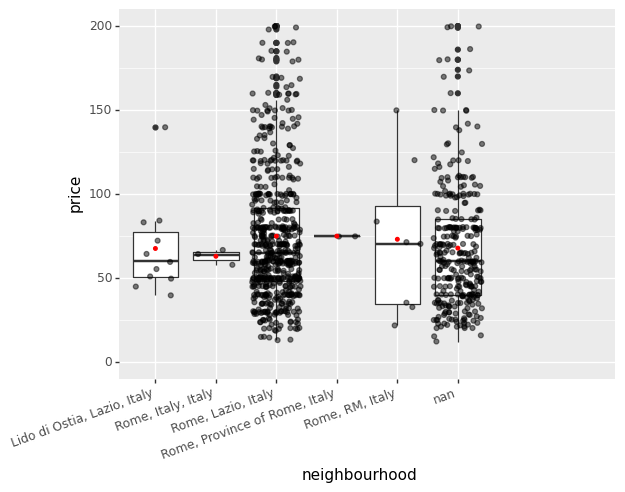

<ggplot: (8787001238241)>

In [ ]:
ggplot(ds.sample(1000)) +\
    aes(x='neighbourhood', y='price') +\
    geom_boxplot() +\
    geom_jitter(alpha=0.5) +\
    stat_summary(fun_y=np.mean, geom="point", size=1, color="red", fill="red") +\
    ylim(0, 200) +\
    theme(axis_text_x = element_text(angle = 20, hjust=1))

### Violin plot

/usr/local/lib/python3.7/dist-packages/plotnine/layer.py:324: PlotnineWarning: stat_ydensity : Removed 1722 rows containing non-finite values.
/usr/local/lib/python3.7/dist-packages/plotnine/layer.py:324: PlotnineWarning: stat_summary : Removed 1722 rows containing non-finite values.


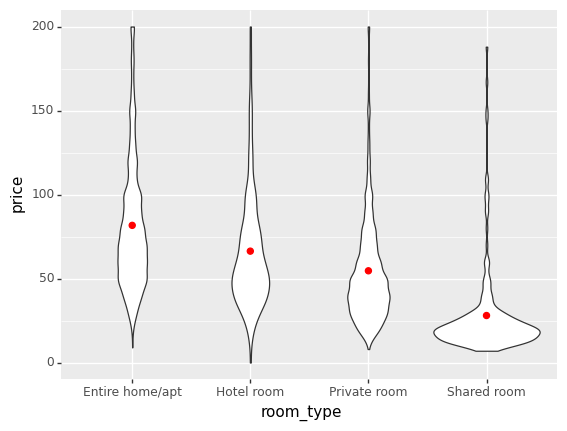

<ggplot: (8787001970793)>

In [ ]:
ggplot(listings_2) +\
    aes(x='room_type', y='price') +\
    geom_violin() +\
    stat_summary(fun_y=np.mean, geom="point", size=2, color="red", fill="red") +\
    ylim(0, 200)

/usr/local/lib/python3.7/dist-packages/plotnine/layer.py:324: PlotnineWarning: stat_ydensity : Removed 47 rows containing non-finite values.
/usr/local/lib/python3.7/dist-packages/plotnine/layer.py:324: PlotnineWarning: stat_summary : Removed 47 rows containing non-finite values.
/usr/local/lib/python3.7/dist-packages/plotnine/layer.py:401: PlotnineWarning: geom_jitter : Removed 49 rows containing missing values.


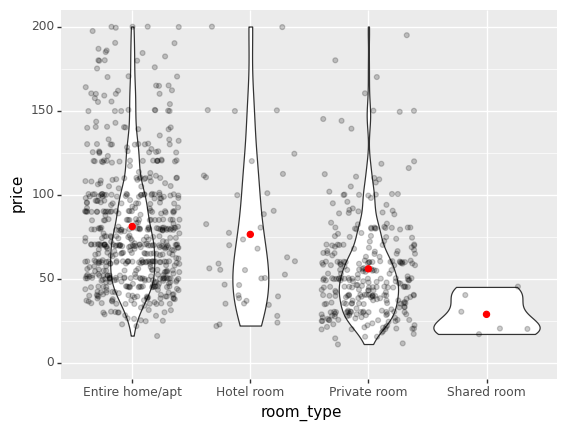

<ggplot: (8787001753801)>

In [ ]:
ggplot(listings_2.sample(1000)) +\
    aes(x='room_type', y='price') +\
    geom_violin() +\
    geom_jitter(alpha = 0.2) +\
    stat_summary(fun_y=np.mean, geom="point", size=2, color="red", fill="red") +\
    ylim(0, 200)

## Heatmaps


In [ ]:
listings_property_room = listings_2\
    .pivot_table(
        columns='room_type',
        values='price',
        index='property_type',
        aggfunc=lambda x: round(np.mean(x),1)
    )
listings_property_room

room_type,Entire home/apt,Hotel room,Private room,Shared room
property_type,,,,
Boat,52.0,NaN,NaN,NaN
Camper/RV,52.5,NaN,NaN,NaN
Campsite,60.0,NaN,NaN,NaN
Casa particular,44.5,NaN,NaN,NaN
Castle,60.0,NaN,NaN,NaN
...,...,...,...,...
Shared room in townhouse,NaN,NaN,NaN,12.0
Tent,28.0,NaN,NaN,NaN
Tiny house,67.5,NaN,NaN,NaN


In [ ]:
!pip install -U plotly==4.14.3
from importlib import reload 
import plotly.express as px
reload(px)


     |████████████████████████████████| 13.2MB 310kB/s 
  Found existing installation: plotly 4.4.1
    Uninstalling plotly-4.4.1:
      Successfully uninstalled plotly-4.4.1


<module 'plotly.express' from '/usr/local/lib/python3.7/dist-packages/plotly/express/__init__.py'>

In [ ]:
fig = px.imshow(
    listings_property_room,
    labels={"x": "room_type", "y": "Property Type", "color": "mean price"},
    x=listings_property_room.columns,
    y=listings_property_room.index
)
fig.show()

In [ ]:
df = listings_2\
     .pivot_table(
        columns='beds',
        values='price',
        index='room_type',
        aggfunc={
            'price': lambda x: round(np.mean(x),0)
        }
    )
df

beds,0.0,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,10.0,11.0,12.0,13.0,14.0,15.0,16.0,17.0,18.0,19.0,20.0,22.0,24.0
room_type,,,,,,,,,,,,,,,,,,,,,,,
Entire home/apt,97.0,83.0,93.0,121.0,127.0,170.0,191.0,201.0,377.0,387.0,415.0,301.0,677.0,267.0,507.0,291.0,325.0,65.0,55.0,551.0,100.0,NaN,466.0
Hotel room,92.0,92.0,83.0,83.0,121.0,135.0,599.0,283.0,182.0,204.0,NaN,NaN,564.0,NaN,NaN,NaN,1500.0,NaN,400.0,NaN,NaN,NaN,114.0
Private room,83.0,90.0,84.0,99.0,90.0,91.0,114.0,189.0,122.0,288.0,136.0,144.0,75.0,NaN,200.0,NaN,78.0,NaN,165.0,518.0,1200.0,15.0,NaN
Shared room,104.0,38.0,51.0,23.0,36.0,22.0,19.0,NaN,17.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:

fig = px.imshow(
    df,
    labels={"x": "Beds", "y": "Room Type", "color": "Mean price"},
    )
fig.show()

In [ ]:
!pip install -U matplotlib
import matplotlib
import matplotlib.pyplot as plt
matplotlib.style.use('ggplot')

     |████████████████████████████████| 10.3MB 4.3MB/s 
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: matplotlib 3.2.2
    Uninstalling matplotlib-3.2.2:
      Successfully uninstalled matplotlib-3.2.2


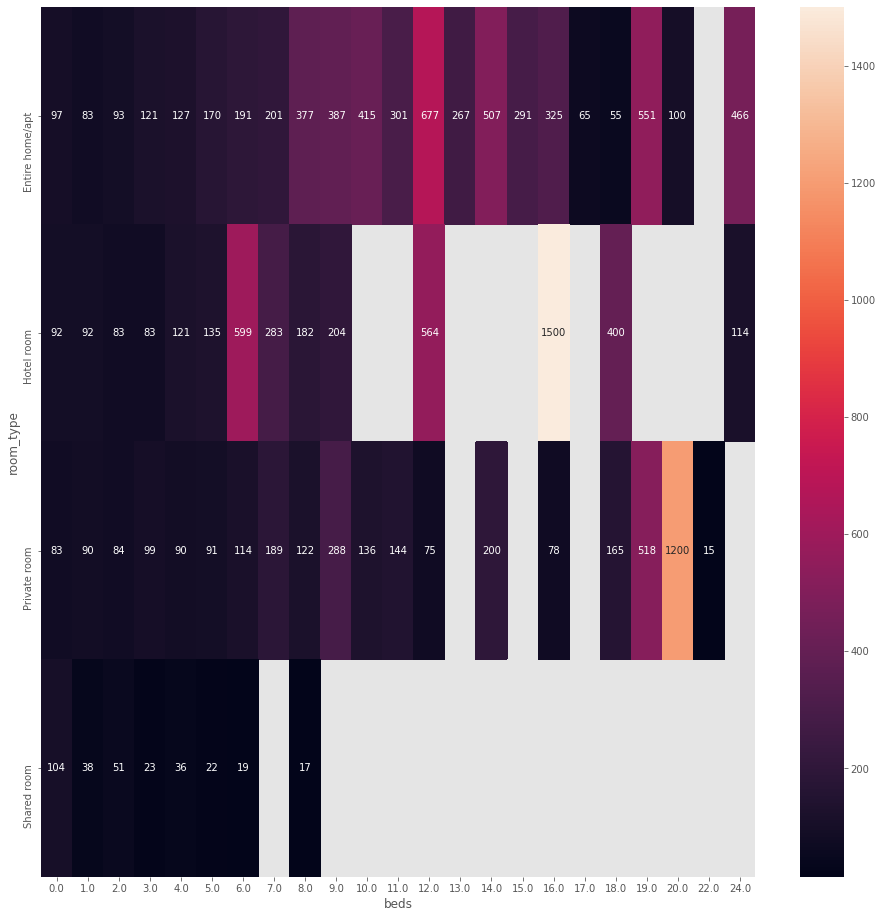

In [ ]:
#Plotting the same on a heatMap
import seaborn as sns

plt.figure(figsize=(16,16))
ax = sns.heatmap(df,annot=True, fmt=".0f")
# bottom, top = ax.get_ylim()
# ax.set_ylim(bottom + 0.5, top - 0.5)
ax

# Plotly!

Plotly is a library for building interactive charts with a good quality for publishing as well.  
It allows you to create many different charts and visualization, useful also for dashboards.

It's possible to use Plotly also with Javascript and R, the library is different, but also quite similar :)

There are many ways to create and visualize charts with Plotly, a simple one is definitely use: `plotly express`.

Documentation: https://plotly.com/python/  

Plotly Express documentation: https://plotly.com/python/plotly-express/

In [ ]:
#Importing matplotlib
#Importing seaborn
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import seaborn as sns

#Importing plotly
import plotly
import plotly.express as px #plotly express
import plotly.graph_objects as go #plotly graph object

# Maps

In [ ]:
listings_2.head()

,id,name,longitude,latitude,instant_bookable,host_response_time,neighbourhood,review_scores_rating,property_type,room_type,accommodates,bathrooms,bedrooms,beds,reviews_per_month,number_of_reviews,price
0,2737,"Elif's room in cozy, clean flat.",12.48355,41.87218,f,within a day,"Rome, Lazio, Italy",96.0,Private room,Private room,1,NaN,1.0,0.0,0.09,7,21.0
1,2903,Stay a night in Calisto6 B&B Rome,12.47002,41.88826,f,within a few hours,NaN,86.0,Private room in bed and breakfast,Private room,4,NaN,1.0,2.0,0.37,55,37.0
2,3079,Cozy apartment (2-4)with Colisseum view,12.49163,41.89503,f,NaN,"Rome, Lazio, Italy",88.0,Entire apartment,Entire home/apt,4,NaN,1.0,4.0,0.14,17,105.0
3,11834,"Roma ""Charming Boschetto House""",12.49058,41.89574,f,NaN,NaN,95.0,Entire apartment,Entire home/apt,2,NaN,1.0,1.0,1.19,142,90.0
4,12398,Casa Donatello - Home far from Home,12.46809,41.92584,f,within an hour,"Rome, Lazio, Italy",98.0,Entire apartment,Entire home/apt,5,NaN,2.0,3.0,0.32,40,73.0


[scatter_mapbox](https://plotly.com/python/scattermapbox/)

In [ ]:
fig = px.scatter_mapbox(listings_2.head(10000), lat="latitude", lon="longitude", color="room_type", size="price",
                        color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=10,
                        hover_name="name",
                        mapbox_style="carto-positron"
                        )
fig.show()

# Timeseries

In [ ]:
import plotly.express as px
import pandas as pd

df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/finance-charts-apple.csv')
df.head()

,Date,AAPL.Open,AAPL.High,AAPL.Low,AAPL.Close,AAPL.Volume,AAPL.Adjusted,dn,mavg,up,direction
0,2015-02-17,127.489998,128.880005,126.919998,127.830002,63152400,122.905254,106.741052,117.927667,129.114281,Increasing
1,2015-02-18,127.629997,128.779999,127.449997,128.720001,44891700,123.760965,107.842423,118.940333,130.038244,Increasing
2,2015-02-19,128.479996,129.029999,128.330002,128.449997,37362400,123.501363,108.894245,119.889167,130.884089,Decreasing
3,2015-02-20,128.619995,129.500000,128.050003,129.500000,48948400,124.510914,109.785449,120.763500,131.741551,Increasing
4,2015-02-23,130.020004,133.000000,129.660004,133.000000,70974100,127.876074,110.372516,121.720167,133.067817,Increasing


In [ ]:

fig = px.line(df, x='Date', y='AAPL.High', title='Time Series with Rangeslider')

fig.update_xaxes(rangeslider_visible=True)
fig.show()